# Haar Cascade Classifier Detecting Objects in Videos

* Using pretrained Haar cascade classifiers to detect persons and cars in videos;
* Video with many persons walking and interacting in a street. The objective is to detect and keep track of them throughout the video;
* Video of cars transiting on a highway. The objective is to detect and keep track of the cars in the video;
* Unix command `ffmpeg` is used to convert videos from ".avi" format to ".mp4" to display them in the notebook;
* HTML simple code creates a video display in the notebook;
* Discussions about the reasons behind our fine tuning of Haar classifiers parameters;
* Haar cascade classifiers were first proposed in the 2001 paper [Rapid Object Detection using a Boosted Cascade of Simple
Features](https://www.cs.cmu.edu/~efros/courses/LBMV07/Papers/viola-cvpr-01.pdf)

In [ ]:
from base64 import b64encode

import cv2
import numpy as np
from matplotlib import pyplot as plt
from IPython.display import HTML

## Data Exploration

Function `imshow` created below can plot any OpenCV image coming in BGR format. Before plotting, it converts the image to RGB and resize it using the "size" argument. "size" refers to the desired height for the image. Width is automatically calculated by maintaining the aspect ratio of the original-sized image.

We cannot use OpenCV's `imshow` since it causes crashes on Google's Colab.

In [ ]:
def imshow(image, title="Image", size=8):
    """Convert image to RGB format and plot it in a given size 
    maintaining the aspect ratio.

    Args:
        image (numpy.ndarray): Image to plot.
        title (str, optional): Plot title. Defaults to "Image".
        size (int, optional): Image height to use in plot, in inches.
    """
    h, w = image.shape[0], image.shape[1]
    aspect_ratio = w / h
    plt.figure(figsize=(size * aspect_ratio, size))
    plt.title(title)
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.show()

Since we are proposing a method for detecting objects in videos, we need to actually look at the images to understand our data.

However, Jupyter notebooks have limitations considering the video types they can exhibit. For that reason, we need to convert our two case study videos from ".avi" format to ".mp4". Linux has the off-the-shelf `ffmpeg` command for that.

In [ ]:
!ffmpeg -i walking.avi walking.mp4 -y

!ffmpeg -i cars.avi cars.mp4 -y

ffmpeg version 3.4.11-0ubuntu0.1 Copyright (c) 2000-2022 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-li

With our videos converted to ".mp4", we can then read them as any binary file using Python's `open` function. Videos are encoded in Base64, so we decode them before displaying.

We can use IPython's `HTML` function to create a small sample of HTML code to show our videos.

There are specific characteristics in these videos that need attention so we can decide the best parameters for our Haar cascade classifiers:
1. Video length: if the video is lengthy, we may want to set faster parameters for our method, thinking about efficiency;
2. Image quality: with a better resolution, our task becomes easier because objects can be identified easier. This means that we can use less sensitive parameter configurations;
3. Image scale and object sizes: Haar cascade classifiers are trained using a specific scale for the objects. If object sizes in test images do not match the object size in the training images, we need to set smaller minimum object size and scale factor parameters;
4. Number of objects we can detect: Every object in the image that looks similar to the wanted object is considered a candidate. Each candidate in the image goes through a series of thousands of filters before it is classified as the object we want. The more candidate objects to be filtered, the more time to evaluate the whole video.

In [ ]:
mp4 = open('walking.mp4', 'rb').read()
data_src = "data:video/mp4;base64," + b64encode(mp4).decode()

HTML("""
    <video controls>
        <source src="%s" type="video/mp4">
    </video>
""" % data_src)

## Person Detection Model Building

OpenCV has many solid pretrained Haar classifier models for recognizing objects in images, including one for full body detection, that we can use to detect persons in our first video. The full list of these pretrained models can be found at OpenCV's [GitHub repository](https://github.com/opencv/opencv/tree/4.x/data/haarcascades). The model we use for person detection is also available at the "models" folder of the repository having this notebook.

OpenCV's `CascadeClassifier` has a constructor that can load pretrained Haar cascade classifiers from ".xml" files. We can pass our pretrained model to it and then use the `detectMultiScale` method from the instance to detect persons.

Videos are just a sequence of frames. We can identify persons and draw rectangles around them in every one of these frames, eventually building another video.

Firstly, we can open just the first frame of the video and try to fit our model to that frame to get an initial version of our method. As we can see, the first frame has 3 persons having more or less the same size in the picture. Unfortunately, the classifiers are not able to detect the person more to the right, no matter the parameter configuration. That person is only detectable in the next frames of the video, once he stops looking down.

We can fit `scaleFactor` and `minNeighbors` parameters to correctly identify those persons. However, by doing that we can overfit our method. We need to have this in mind because, in the full video, a person comes from the background in a small scale. The scale is small enough to be very different to that of the persons in the first frame.

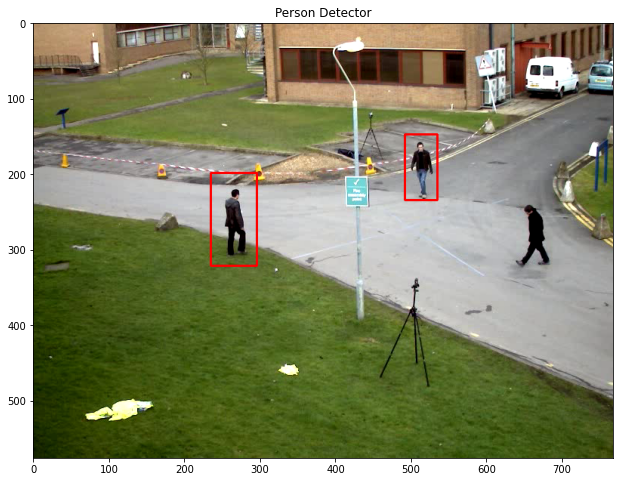

In [ ]:
haar_person_detector = cv2.CascadeClassifier('haarcascade_fullbody.xml')

cap = cv2.VideoCapture('walking.avi')

ret, frame = cap.read()
if ret:
    # If there is a frame loaded, convert it to grayscale, for
    # performance purposes, and process it.
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    bodies = haar_person_detector.detectMultiScale(gray, scaleFactor=1.1,
                                                   minNeighbors=5)

    # Draw rectangles around the persons using the returned coordinates.
    for (x, y, w, h) in bodies:
        cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 0, 255), 2)

cap.release()

imshow(frame, "Person Detector")

For the entire video, we will do basically the same thing we did for the first frame. Since we are creating a new video using the new frames with rectangles around people, we need to get the width and height of the original video.

OpenCV's `VideoWriter` class allow us to instantiate a video buffer with a specific video codec, frame rate and frame size. In this video buffer we will write every single recreated frame, after the persons in it have been detected.

We save the video in ".avi" format to follow the original video format. Because of this, after completing the video, we have to convert it to ".mp4" to be able to display it in the notebook using HTML.

In [ ]:
cap = cv2.VideoCapture('walking.avi')

# Get width and height of the original video.
w = int(cap.get(3))
h = int(cap.get(4))

# Use the same codec, frame rate and frame size of the original video.
output = cv2.VideoWriter('walking_output.avi',
                         cv2.VideoWriter_fourcc('M', 'J', 'P', 'G'),
                         fps=10,
                         frameSize=(w, h))

ret, frame = cap.read()
while(ret):
    # While there is a frame loaded, convert it to grayscale, for
    # performance purposes, and process it.
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    bodies = haar_person_detector.detectMultiScale(gray, scaleFactor=1.08,
                                                   minNeighbors=8)

    # Draw rectangles around the persons using the returned coordinates.
    for (x, y, w, h) in bodies:
        cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 0, 255), 2)
    
    output.write(frame)
    ret, frame = cap.read()

cap.release()
output.release()

In [ ]:
!ffmpeg -i walking_output.avi walking_output.mp4 -y

ffmpeg version 3.4.11-0ubuntu0.1 Copyright (c) 2000-2022 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-li

In [ ]:
mp4 = open('walking_output.mp4', 'rb').read()
data_src = "data:video/mp4;base64," + b64encode(mp4).decode()

HTML("""
    <video controls>
        <source src="%s" type="video/mp4">
    </video>
""" % data_src)

We can see that our method is good a detecting and keeping track of the persons in the video, even if they are many. Some notes taken:

* The person coming from the background is detected a couple of times throughout the video, but the classifiers are not able to really track her.

* The person more to the right in the first frame takes a bit of time to be detected. That happens because he is walking with his head down, with a body position that our classifiers were not trained for.

* There is a person opening a car trunk in the background at the end of the video. That is the only person which is not detected at least once. That happens because he is tiny in the picture, having a small scale and occupying a small number of pixels.

* We can see that the method has a hard time detecting persons when their faces are hidden. Especially when said persons are small in the picture, as the model does not have many pixels to find them.

* A couple of false positives happen during the scene, if `detectMultiScale` parameters are not configured properly. The rock near the street and the camera tripod have a large tendency for being false positives. This means that those two objects can go through many Haar filters, fooling them. With our final parameter configuration, that does not happen.

Even if not perfect, and not on par with current state-of-the-art models (YOLOv3), this is an impressive result. Remember that this is an algorithm from 2001 that was trained using generic human body images.

## Car Detection Model Building

We have a traffic video with multiple cars and other vehicles crossing a highway. The objective is to track the cars avoiding false positives. This video is shorter than the previous one and has a smaller resolution, so it is cheaper to process. Some van cars are also in the video, we are also going to try to track them. However, we aim to make the algorithm ignore the truck and the bicycle in the video.

As we can see in the video, there are a couple of overlays with informations such as date and time. This is a monitoring system built to detect pedestrians and bicycle on the highway. One additional overlay pops up once the biker is detected by the monitoring system. We want our method to ignore these overlays always. Unfortunately, they will interfere on our task by covering the images.

We are not going to perform any preprocessing to remove these overlays as we want to stick with the original video and also test the ability of our method to ignore such artifacts.

In [ ]:
mp4 = open('cars.mp4', 'rb').read()
data_src = "data:video/mp4;base64," + b64encode(mp4).decode()

HTML("""
    <video controls>
        <source src="%s" type="video/mp4">
    </video>
""" % data_src)

Now we load another pretrained Haar cascade classifier using OpenCV's `CascadeClassifier` class constructor. This time, the loaded model is trained to detect cars in images. It is not available in OpenCV's repositories, being only available at the "models" folder of the repository having this notebook.

Once again, we start by fine tuning the parameters for the method using the first frame of the video. We are able to fine tune the method to the point where almost every car in the first frame is detected. The only exception is a car that is very far away from the camera. We allow that false negative because if the video was longer, the car would have been closer to the camera and probably detected.

Note that even the gray car more to the left of the frame is detected. Even if its image is incomplete. Unfortunately, we are not able to keep this level of fine tuning in the full video as it leads to many false positives.

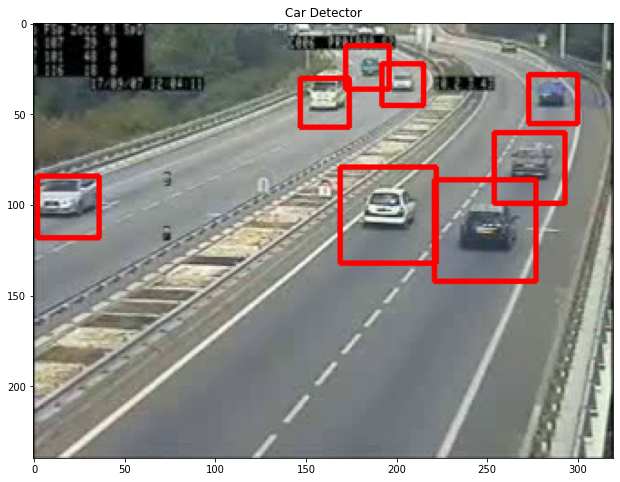

In [ ]:
haar_car_detector = cv2.CascadeClassifier('haarcascade_car.xml')

cap = cv2.VideoCapture('cars.avi')

ret, frame = cap.read()
if ret:
    # If there is a frame loaded, convert it to grayscale, for
    # performance purposes, and process it.
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    bodies = haar_car_detector.detectMultiScale(gray, scaleFactor=1.01,
                                                minNeighbors=5)

    # Draw rectangles around the persons using the returned coordinates.
    for (x, y, w, h) in bodies:
        cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 0, 255), 2)

cap.release()

imshow(frame, "Car Detector")

In the full video, we follow as close as possible the parameters chosen for the first frame. To eliminate most false positives, we increase `minNeighbors` to 12. This means that the algorithm is more conservative as every candidate region in the image needs to have 12 candidate neighboring regions.

In [ ]:
cap = cv2.VideoCapture('cars.avi')

# Get width and height of the original video.
w = int(cap.get(3))
h = int(cap.get(4))

# Use the same codec, frame rate and frame size of the original video.
output = cv2.VideoWriter('cars_output.avi',
                         cv2.VideoWriter_fourcc('M', 'J', 'P', 'G'),
                         fps=25,
                         frameSize=(w, h))

ret, frame = cap.read()
while(ret):
    # While there is a frame loaded, convert it to grayscale, for
    # performance purposes, and process it.
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    cars = haar_car_detector.detectMultiScale(gray, scaleFactor=1.01,
                                              minNeighbors=12)

    # Draw rectangles around the persons using the returned coordinates.
    for (x, y, w, h) in cars:
        cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 0, 255), 2)

    output.write(frame)
    ret, frame = cap.read()

cap.release()
output.release()

In [ ]:
!ffmpeg -i cars_output.avi cars_output.mp4 -y

ffmpeg version 3.4.11-0ubuntu0.1 Copyright (c) 2000-2022 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-li

In [ ]:
mp4 = open('cars_output.mp4', 'rb').read()
data_src = "data:video/mp4;base64," + b64encode(mp4).decode()

HTML("""
    <video controls>
        <source src="%s" type="video/mp4">
    </video>
""" % data_src)

For this last video of ours we say that the detection was even better than the person detection. Even though more mistakes were made, the cars were tracked on the road with more success and with bounding boxes that fit better to each car. Some notes taken:

* The gray car more to the left of the first frame was not detected using the final parameter configuration. We pay with this false negative to avoid many other false positives. We argue that if the video was longer, and the car was filmed before, it would probably have been detected, considering that its image is not complete in the first frame;

* Every other car is detected at least once, with cars on the left road being harder to track, especially the smaller ones;

* The truck and the bicycle are indeed not detected as cars. However, the rear bumper of the truck is pointed out as a car a couple of times;

* Our method successfully ignores all overlays except for the one that appears for last. In that case, it keeps constantly marking that box of text as a car. Tweaking with parameters did not help to ignore it, not without also ignoring some cars.

The conclusion is that these pretrained Haar cascade classifiers can detect objects in videos with a reasonably good performance. Especially considering that the algorithm was proposed in 2001, many years before the deep learning boom. There were problems with the overlays in the car traffic video. However, they could be easily removed from the camera feed itself, as they are not originally part of the camera images, but part of the monitoring system.